In [1]:
import pandas as pd
import numpy as np


In [11]:
path="C:\\Users\\sahil\\Desktop\\DataScience\\archive\\augmented_faces.npy"
X = np.load(path)

print(type(X))   
print(X.shape)   
print(X) 

<class 'numpy.ndarray'>
(2000, 64, 64)
[[[0.30991736 0.36776859 0.41735536 ... 0.37190083 0.33057851 0.30578512]
  [0.3429752  0.40495867 0.43801653 ... 0.37190083 0.33884299 0.3140496 ]
  [0.3429752  0.41735536 0.45041323 ... 0.38016528 0.33884299 0.29752067]
  ...
  [0.21487603 0.20661157 0.22314049 ... 0.15289256 0.16528925 0.17355372]
  [0.20247933 0.2107438  0.2107438  ... 0.14876033 0.16115703 0.16528925]
  [0.20247933 0.20661157 0.20247933 ... 0.15289256 0.16115703 0.1570248 ]]

 [[0.30578512 0.33057851 0.37190083 ... 0.41735536 0.36776859 0.30991736]
  [0.3140496  0.33884299 0.37190083 ... 0.43801653 0.40495867 0.3429752 ]
  [0.29752067 0.33884299 0.38016528 ... 0.45041323 0.41735536 0.3429752 ]
  ...
  [0.17355372 0.16528925 0.15289256 ... 0.22314049 0.20661157 0.21487603]
  [0.16528925 0.16115703 0.14876033 ... 0.2107438  0.2107438  0.20247933]
  [0.1570248  0.16115703 0.15289256 ... 0.20247933 0.20661157 0.20247933]]

 [[0.         0.         0.         ... 0.08619577 0.    

In [12]:
X.shape

(2000, 64, 64)

In [13]:
path2="C:\\Users\\sahil\\Desktop\\DataScience\\archive\\augmented_labels.npy"
Y = np.load(path2)

In [14]:
Y.shape

(2000,)

In [17]:
import matplotlib.pyplot as plt 


In [18]:
def compression_ratio(m, n, k):
    return (m*n) /(m*k + n*k + k)

In [19]:
def reconstruction_error(A, A_k):
    return (np.linalg.norm(A - A_k, 'fro')**2 / np.linalg.norm(A, 'fro')**2)*100

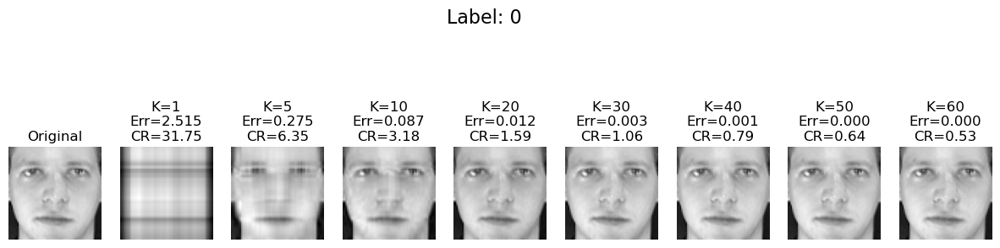

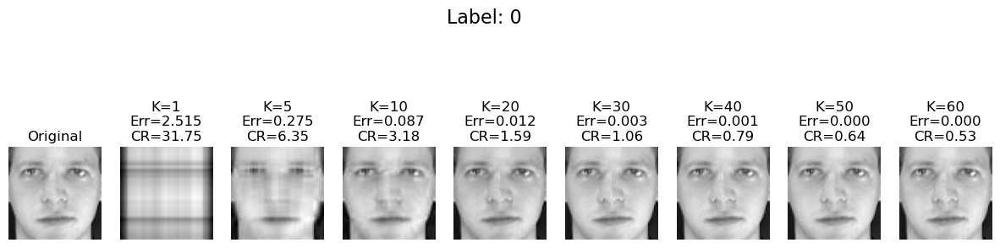

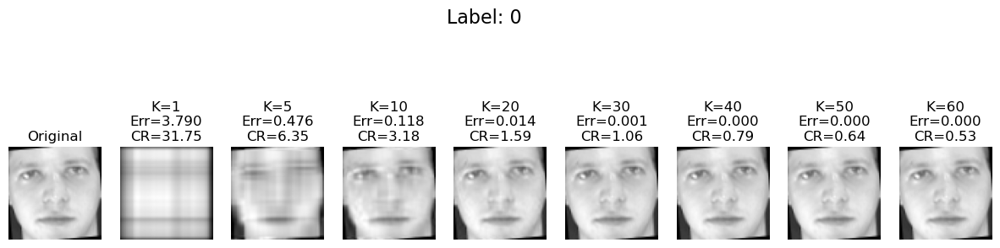

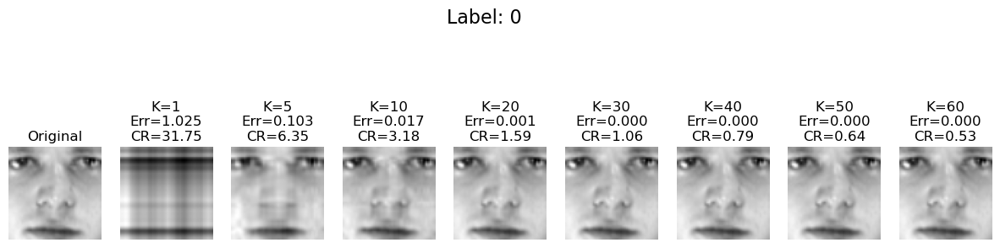

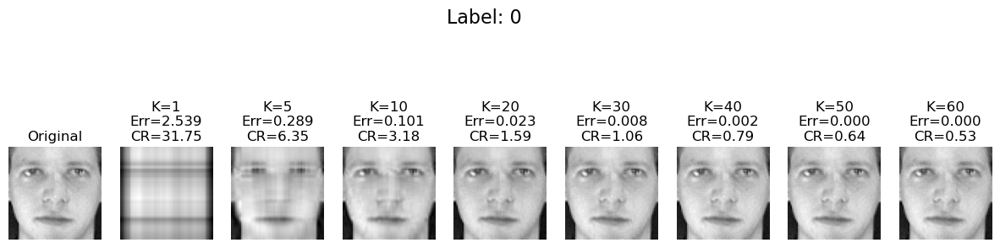

...

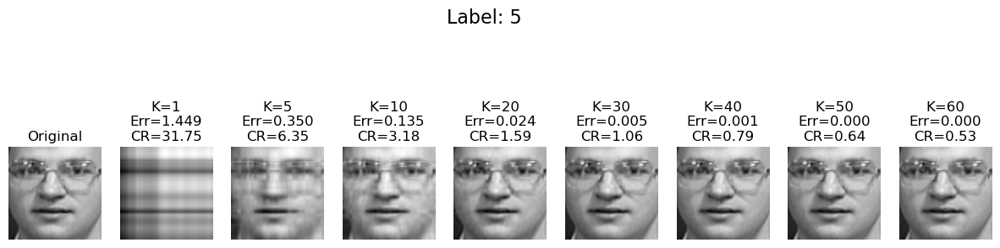

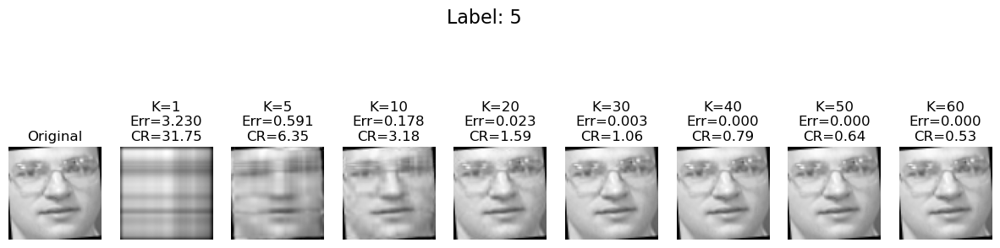

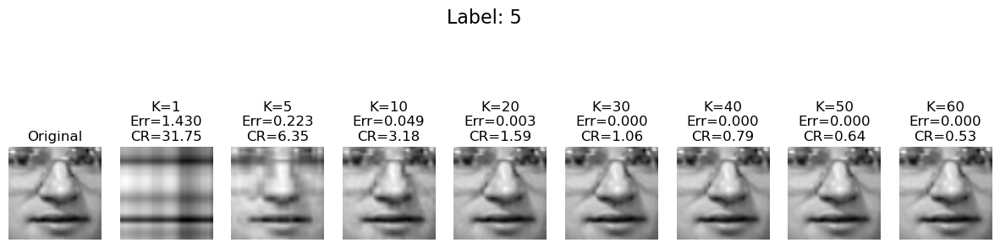

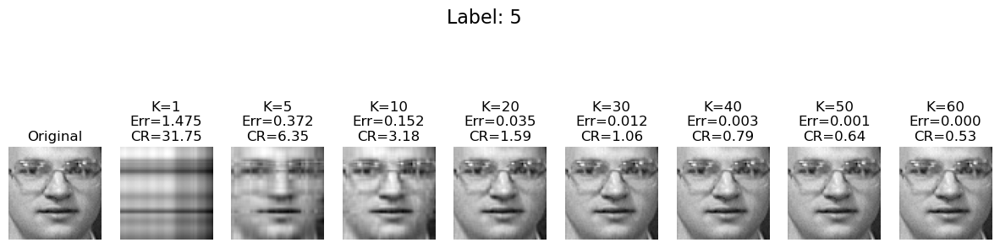

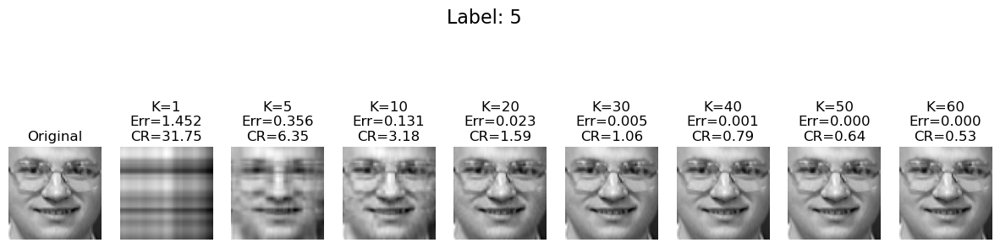

KeyboardInterrupt: 

In [36]:
for i in range(1000):
    img = X[i]
    label = Y[i]
    
    right = (img.T) @ (img)
    eigen_val, eigen_vec = np.linalg.eig(right)
    idx = eigen_val.argsort()[::-1]
    eigen_val = eigen_val[idx]
    eigen_vec = eigen_vec[:, idx]
    
    k_list = [1, 5, 10, 20, 30, 40, 50, 60]
    errors = []
    ratios = []
    
    plt.figure(figsize=(15, 8))
    plt.subplot(2, len(k_list)+1, 1)
    plt.imshow(img, cmap="gray")
    plt.title("Original")
    plt.axis("off")

    
    subplot_index = 2  

    for k in k_list:
        V = eigen_vec[:, :k]
        singular_vals = np.sqrt(np.maximum(eigen_val[:k], 0))
        U = (img @ V) / (singular_vals[np.newaxis, :]+1e-10)
        sigma = np.diag(singular_vals)
        img_reconstructed = U @ sigma @ V.T
        img_reconstructed = np.clip(np.real(img_reconstructed), 0, 1)
        
        err = reconstruction_error(img, img_reconstructed)
        cr = compression_ratio(img.shape[0], img.shape[1], k)
        errors.append(err)
        ratios.append(cr)

        plt.subplot(2, len(k_list)+1, subplot_index)
        plt.imshow(img_reconstructed, cmap="gray")
        plt.title(f"K={k}\nErr={err:.3f}\nCR={cr:.2f}")
        plt.axis("off")
        subplot_index += 1

    plt.suptitle(f"Label: {label}", fontsize=16)
    plt.show()


In [37]:
#Now I know i have classes and images of that classes so i need to split the dataset into 80(train data) and 20(test data)
#Now for each sample in test class we have To predict its class using train data calculate its distance with all other train data and then find the minimum dist
#assign same class to that test sample as the train data 
#For Diff K find Diff accuracy and Finally plot a graph between K vs accuracy 